In [ ]:
!pip install datamapplot

  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 168.5/168.5 kB 8.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 46.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 18.3/18.3 MB 68.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.2/49.2 kB 3.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.4/1.4 MB 55.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 41.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 244.3/244.3 kB 16.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 43.3/43.3 kB 2.6 MB/s eta 0:00:00
  Created wheel for Pyqtree: filename=Pyqtree-1.0.0-py3-none-any.whl size=5969 sha256=dde7a46552bd88e00e93284efb20fc3bff6334e2301634d178c541d1bedd296b
  Stored in directory: /root/.cache/pip/wheels/86/02/24/506ac193949f48c8bec599b613d722bd64a83063a190b3bff7
Successfully built Pyqtree
  Attempting uninstall: dask
    Found existing

In [ ]:
import pandas as pd
import json
import matplotlib
matplotlib.rcParams["figure.dpi"] = 72
import datamapplot

umap_df = pd.read_csv("umap_cluster_2d.csv")
data_df = pd.DataFrame(json.load(open("final_paper_summaries.json")))

murex_data_map = umap_df[["umapX", "umapY"]].fillna(0).to_numpy()
murex_label_layers_1 = umap_df["5L_Layer_1"].fillna("").to_numpy()
murex_label_layers_2 = umap_df["5L_Layer_2"].fillna("").to_numpy()
murex_label_layers_3 = umap_df["5L_Layer_3"].fillna("").to_numpy()
murex_label_layers_4 = umap_df["5L_Layer_4"].fillna("").to_numpy()
murex_label_layers_5 = umap_df["5L_Layer_5_Final"].fillna("").to_numpy()
hover_data = data_df["title"].to_numpy()

In [ ]:
def format_tools_to_html(tools_list, color):
    if not isinstance(tools_list, list):
        return ""

    tags_html = "".join([
        f"""
        <div style="
            background-color: {color};
            color: #fff;
            border-radius: 6px;
            padding: 2px 10px;
            font-size: 7pt;
            font-weight: 600;
        ">
            {tool}
        </div>
        """ for tool in tools_list
    ])

    return f'<div style="display: flex; flex-wrap: wrap; gap: 5px;">{tags_html}</div>'

data_df["techniques_tools_html"] = data_df["techniques_tools"].apply(format_tools_to_html, color="#2a5982")
data_df["key_concepts_html"] = data_df["key_concepts"].apply(format_tools_to_html, color="#d6ac4b")

In [ ]:
custom_tooltip_css = """
    max-width: none !important;  /* Allow the width to expand beyond default limits */
    width: auto !important;      /* Let content dictate the width */
    background: transparent !important; /* Hide the default black/grey box */
    box-shadow: none !important; /* Remove default shadow */
    padding: 0 !important;       /* Remove default padding */
    border: none !important;     /* Remove any borders */
    pointer-events: none;        /* Standard setting: allows mouse to pass through if needed */
"""

In [54]:
hover_text_template = """
<div style="
    font-family: -apple-system, BlinkMacSystemFont, 'Segoe UI', Roboto, Helvetica, Arial, sans-serif;
    width: 750px;
    background: #fff;
    border: 1px solid #e5e7eb;
    border-radius: 10px;
    box-shadow: 0 8px 24px rgba(0,0,0,0.12);
    overflow: hidden;
    color: #0f172a;
    text-align: left;
    position: relative; /* Essential for the absolute positioning logic */
">

    <div style="
        position: absolute;
        top: 0;
        left: 0;
        bottom: 0;
        width: 58%;
        padding: 20px;
        overflow-y: auto;
        box-sizing: border-box;
    ">
        <h2 style="margin: 0 0 6px 0; font-size: 16px; font-weight: 700; color: #1e293b; line-height: 1.3;">{hover_text}</h2>

        <div style="font-size: 11px; color: #64748b; font-weight: 600; margin-bottom: 6px;">
            Online Published: {year}
        </div>
        <div style="display: flex; flex-wrap: wrap; gap: 4px; margin-bottom: 6px;">
            <div style="background-color: #2a5982; color: #fff; width: fit-content; border-radius: 6px; padding: 2px 10px; font-size: 7pt; font-weight: 600;">
                {domain}
            </div>
            <div style="background-color: #d6ac4b; color: #fff; width: fit-content; border-radius: 6px; padding: 2px 10px; font-size: 7pt; font-weight: 600;">
                {data_type}
            </div>
        </div>

        <div style="font-size: 11px; font-weight: 700; color: #2a5982; text-transform: uppercase; margin-bottom: 6px; letter-spacing: 0.5px;">Abstract</div>
        <p style="margin: 0; font-size: 12.5px; line-height: 1.5; color: #334155; text-align: justify;">{original_abstract}</p>
    </div>

    <div style="
        margin-left: 58%;
        width: 42%;
        padding: 20px;
        background-color: #f8fafc;
        border-left: 1px solid #e2e8f0;
        box-sizing: border-box;
        height: fit-content;
    ">

        <div style="margin-bottom: 16px;">
            <div style="font-size: 12px; font-weight: 700; color: #2a5982; margin-bottom: 6px;">Explain like I’m 5</div>
            <p style="margin: 0; font-size: 12.5px; line-height: 1.45; color: #0f172a;">{summary_simple}</p>
        </div>

        <div style="margin-bottom: 16px;">
            <div style="font-size: 12px; font-weight: 700; color: #2a5982; margin-bottom: 6px;">Main Findings</div>
            <p style="margin: 0; font-size: 12.5px; line-height: 1.45; color: #0f172a;">{main_findings}</p>
        </div>

        <div style="margin-bottom: 16px;">
            <div style="font-size: 12px; font-weight: 700; color: #2a5982; margin-bottom: 6px;">Methodology</div>
            <p style="margin: 0; font-size: 12.5px; line-height: 1.45; color: #0f172a;">{methodology}</p>
        </div>

        <div style="margin-bottom: 16px;">
            <div style="font-size: 12px; font-weight: 700; color: #2a5982; margin-bottom: 5px;">Techniques Tools</div>
            <div style="display: flex; flex-wrap: wrap; gap: 4px;">
                {techniques_tools_html}
            </div>
        </div>

        <div>
            <div style="font-size: 12px; font-weight: 700; color: #d6ac4b; margin-bottom: 5px;">Key concepts</div>
            <div style="display: flex; flex-wrap: wrap; gap: 4px;">
                {key_concepts_html}
            </div>
        </div>

    </div>
</div>
""".replace('\n', '')

<InteractiveFigure width=100% height=800>
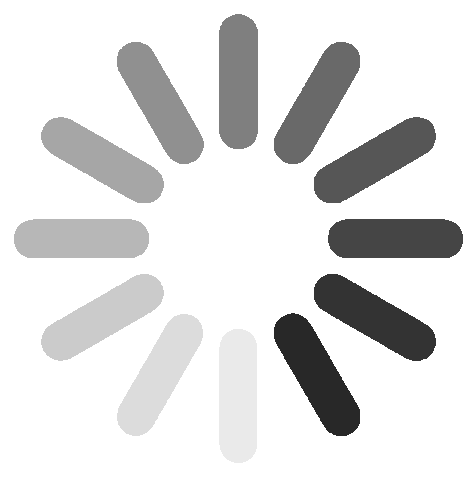

In [55]:
cols = [
    "title",
    "year",
    "domain",
    "summary_simple",
    "main_findings",
    "original_abstract",
    "methodology",
    "data_type",
    "techniques_tools_html",
    "key_concepts_html",
]
plot = datamapplot.create_interactive_plot(
    murex_data_map,
    murex_label_layers_1,
    murex_label_layers_2,
    murex_label_layers_3,
    murex_label_layers_4,
    murex_label_layers_5,
    hover_text=pd.Series(data_df["title"]).fillna(""),
    noise_label="",
    cluster_boundary_line_width=6,
    enable_search=True,
    color_label_text=False,
    title="MUREX Research",
    sub_title="Papers at Mahidol University from 2021 to 2025",
    logo="https://mahidol.ac.th/documents/CI/update/Mahidol/10.png",
    logo_width=128,
    extra_point_data=data_df[cols].fillna(""),
    hover_text_html_template=hover_text_template,
    histogram_data=pd.to_datetime("06/" + data_df['year'].astype(str), format='%m/%Y'),
    histogram_group_datetime_by="year",
    histogram_range=(pd.to_datetime("2021-01-01"), pd.to_datetime("2026-01-01")),
    tooltip_css=custom_tooltip_css,
    #on_click="window.open(`http://google.com/search?q=\"{hover_text}\"`)",
)
plot

In [56]:
plot.save("index.html")

In [57]:
def patch_datamapplot_with_logs(filename):
    print(f"--- Opening {filename} ---")
    try:
        with open(filename, "r", encoding="utf-8") as f:
            content = f.read()
    except FileNotFoundError:
        print(f"Error: Could not find file '{filename}'")
        return

    replacements = [
        (
            "Disable Original Click",
            ".on('click',e=>this.#handleClick(e))",
            ".on('dummy_click',e=>this.#handleClick(e))"
        ),
        (
            "Remap MouseMove -> Click",
            ".on('mousemove',e=>this.#handleMouseMove(e))",
            ".on('click',e=>this.#handleMouseMove(e))"
        ),
        (
            "Remap MouseLeave -> DoubleClick",
            ".on('mouseleave',e=>this.#handleMouseLeave(e))",
            ".on('dblclick',e=>this.#handleMouseLeave(e))"
        )
    ]

    changes_made = 0

    for name, target, replacement in replacements:
        if target in content:

            index = content.find(target)

            start_context = max(0, index - 20)
            end_context = min(len(content), index + len(target) + 20)
            context_snippet = content[start_context:end_context]

            print(f"\n[FOUND] {name}")
            print(f"   Location index: {index}")
            print(f"   Original Context:  ...{context_snippet}...")

            content = content.replace(target, replacement)

            new_context = context_snippet.replace(target, replacement)
            print(f"   Replaced Context:  ...{new_context}...")
            changes_made += 1
        else:
            print(f"\n[MISSING] Could not find target for: {name}")
            print(f"   Looking for: {target}")

    if changes_made > 0:
        print(f"\n--- Saving changes to {filename} ---")
        with open(filename, "w", encoding="utf-8") as f:
            f.write(content)
        print(f"Success! {changes_made} changes applied.")
    else:
        print("\nNo changes were made. The file might already be patched or the syntax differs.")

patch_datamapplot_with_logs("index.html")

--- Opening index.html ---

[FOUND] Disable Original Click
   Location index: 134477
   Original Context:  ...handleMouseLeave(e)).on('click',e=>this.#handleClick(e));const maxK=(binCoun...
   Replaced Context:  ...handleMouseLeave(e)).on('dummy_click',e=>this.#handleClick(e));const maxK=(binCoun...

[FOUND] Remap MouseMove -> Click
   Location index: 134387
   Original Context:  ...s.#handleMouseUp(e)).on('mousemove',e=>this.#handleMouseMove(e)).on('mouseleave',e=>...
   Replaced Context:  ...s.#handleMouseUp(e)).on('click',e=>this.#handleMouseMove(e)).on('mouseleave',e=>...

[FOUND] Remap MouseLeave -> DoubleClick
   Location index: 134427
   Original Context:  ...#handleMouseMove(e)).on('mouseleave',e=>this.#handleMouseLeave(e)).on('dummy_click',e=...
   Replaced Context:  ...#handleMouseMove(e)).on('dblclick',e=>this.#handleMouseLeave(e)).on('dummy_click',e=...

--- Saving changes to index.html ---
Success! 3 changes applied.
